---
---
# Лабораторная работа №4. Анализ социальных сетей. Представление друзей социальной сети "Вконтакте" в виде социального графа.

In [36]:
import vk
import json
import time
from tqdm import tqdm

import pandas as pd

In [37]:
def debug(*args):
    print("DEBUG:", *args)

token = ""
session = vk.Session(access_token = token)
api = vk.API(session)

my_id = 191807904

In [38]:
def load_mutual_friends(source_id, target_id):
    #time.sleep(0.3)
    responce = str(api.friends.get(user_id = int(target_id), v='5.95'))
    responce = responce.replace("'", '"')
    return json.loads(responce)['items']

def load_friends_list():
    responce = str(api.friends.get(count=209, user_id = my_id, fields = "bdate, city, sex", v='5.95'))
    responce = responce.replace("'", '"')
    responce = responce.replace("False", '"False"')
    responce = responce.replace("True", '"True"')
    debug("received responce length:", len(responce))
    debug("responce:", responce[90:105])
    return json.loads(responce)['items']

def load_degrees(friends_list):
    degrees = []
    for friend in tqdm(friends_list):
        time.sleep(0.3)
        try:
            responce = str(api.friends.get(user_id = friend['id'], fields = "sex", v='5.95'))
            responce = responce.replace("'", '"')
            array = json.loads(responce)
            degrees.append(len(array))
        except Exception:
            continue
    return degrees


def create_edgelist(friends_list):
    from_vert = []
    to_vert = []
    debug("request mutual friends list:")
    failed_friends = []
    print(friends_list[0])
    friends_list = [friend['id'] for friend in friends_list]
    vtou = {}
    for friend in tqdm(friends_list):
        #debug("friend:", friend['id'])
        from_vert.append(my_id)
        to_vert.append(friend)
        #debug("friend:", friend)
        try:
            mutual_friends = load_mutual_friends(my_id, friend)
            for value in mutual_friends:
                if value not in vtou:
                    vtou[value] = set()
            if friend not in vtou:
                vtou[friend] = set()
            for value in mutual_friends:
                vtou[friend].add(value)
                vtou[value].add(friend)
        except Exception as message:
            failed_friends.append(friend)
            continue

    used_ids = set()
    for v, us in vtou.items():
        for u in us:
            if v > u:
                if (v in friends_list and u in friends_list) or (len(vtou[v]) > 7 and len(vtou[u]) > 7):
                    from_vert.append(v)
                    to_vert.append(u)
                    used_ids.add(v)
                    used_ids.add(u)

    print("used_ids size:", len(used_ids))
    return pd.DataFrame({'from': from_vert, 'to': to_vert})


def create_edgelist_without_me(friends_list):
    from_vert = []
    to_vert = []
    debug("request mutual friends list:")
    failed_friends = []
    friends_list = [friend['id'] for friend in friends_list]
    vtou = {}
    for friend in tqdm(friends_list):
        #debug("friend:", friend['id'])
        from_vert.append(my_id)
        to_vert.append(friend)
        #debug("friend:", friend)
        try:
            mutual_friends = load_mutual_friends(my_id, friend)
            for value in mutual_friends:
                if value not in vtou:
                    vtou[value] = set()
            if friend not in vtou:
                vtou[friend] = set()
            for value in mutual_friends:
                vtou[friend].add(value)
                vtou[value].add(friend)
        except Exception as message:
            failed_friends.append(friend)
            continue

    used_ids = set()
    for v, us in vtou.items():
        for u in us:
            if v > u:
                if u != my_id and v != my_id:
                    if (v in friends_list and u in friends_list) or (len(vtou[v]) > 7 and len(vtou[u]) > 7):
                        from_vert.append(v)
                        to_vert.append(u)
                        used_ids.add(v)
                        used_ids.add(u)

    print("used_ids size:", len(used_ids))
    return pd.DataFrame({'from': from_vert, 'to': to_vert})

def create_colors(G, friends_list):
    ids = []
    colors = []
    for id in G.nodes():
        ids.append(id)
        color = 'red'
        if id == my_id:
            color = 'green'
        elif id % 4 == 0:
            color = 'blue'
        colors.append(color)

    carac = pd.DataFrame({ 'ID':ids, 'colors':colors })
    carac = carac.set_index('ID')
    carac = carac.reindex(G.nodes())
    #carac['colors'] = pd.Categorical(carac['colors'])
    return carac['colors']

In [39]:
friends_list = load_friends_list()
debug("friends_list:", friends_list)
colors = create_colors(friends_list)
edgelist = create_edgelist(friends_list)
debug("edgelist length:", len(edgelist))

DEBUG: received responce length: 58218
DEBUG: responce: an_access_close
DEBUG: friends_list: [{'first_name': 'Artem', 'id': 29658, 'last_name': 'Prokhorov', 'can_access_closed': 'False', 'is_closed': 'True', 'sex': 2, 'bdate': '13.11', 'city': {'id': 1, 'title': 'Moscow'}, 'track_code': 'a73b9d59VxWZfoQMpfRALEdvQlEKaPMty2A0Aejh8-NYoHrqAAc6fsMauFus9xN2QbeU1LkJk0u5'}, {'first_name': 'Roman', 'id': 1165084, 'last_name': 'Eryomkin', 'can_access_closed': 'True', 'is_closed': 'False', 'sex': 2, 'bdate': '9.5', 'city': {'id': 123, 'title': 'Samara'}, 'track_code': '78a2f394Bq0zvzk5e1RhFYgoNeVoi8lNjXFoRpua1glOAvj-A1Vrxj6MWjh9BjJBsamEf9H9sE6NGA0'}, {'first_name': 'Viktor', 'id': 1452598, 'last_name': 'Vakhshtayn', 'can_access_closed': 'True', 'is_closed': 'False', 'sex': 2, 'city': {'id': 1, 'title': 'Moscow'}, 'track_code': 'ed3ae766W3-h3qBJ9vspGRkYe0vgtTeWr5UfzyHI6o2LFrVJibo2FKzsw0un-C5JIpXK0VnDTpWv_Ho'}, {'first_name': 'Mikhail', 'id': 2185977, 'last_name': 'Kamenko', 'can_access_closed': 'F

TypeError: create_colors() missing 1 required positional argument: 'friends_list'

---
---
## Визуализация графа

In [7]:
# libraries
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt


friends_list = load_friends_list()
edgelist = create_edgelist(friends_list)

  0%|                                                                                          | 0/209 [00:00<?, ?it/s]

DEBUG: received responce length: 58218
DEBUG: responce: an_access_close
DEBUG: request mutual friends list:
{'first_name': 'Artem', 'id': 29658, 'last_name': 'Prokhorov', 'can_access_closed': 'False', 'is_closed': 'True', 'sex': 2, 'bdate': '13.11', 'city': {'id': 1, 'title': 'Moscow'}, 'track_code': '2ddd80bcV0JLKrVq5ILCm4AK_82Wv0mf9DIATGjswREd1sBVdqM6KRAYiT2418-Qhp9JfCbcKfmG'}


100%|████████████████████████████████████████████████████████████████████████████████| 209/209 [00:10<00:00, 20.67it/s]


used_ids size: 147


In [8]:
# Build your graph
G=nx.from_pandas_edgelist(edgelist, 'from', 'to')
print("G len:", len(G))

G len: 213


In [10]:
colors = create_colors(G, friends_list)

print(colors[:10])

ID
191807904    green
29658          red
1165084       blue
1452598        red
2185977        red
2520703        red
3973919        red
6321647        red
6535322        red
6669859        red
Name: colors, dtype: object


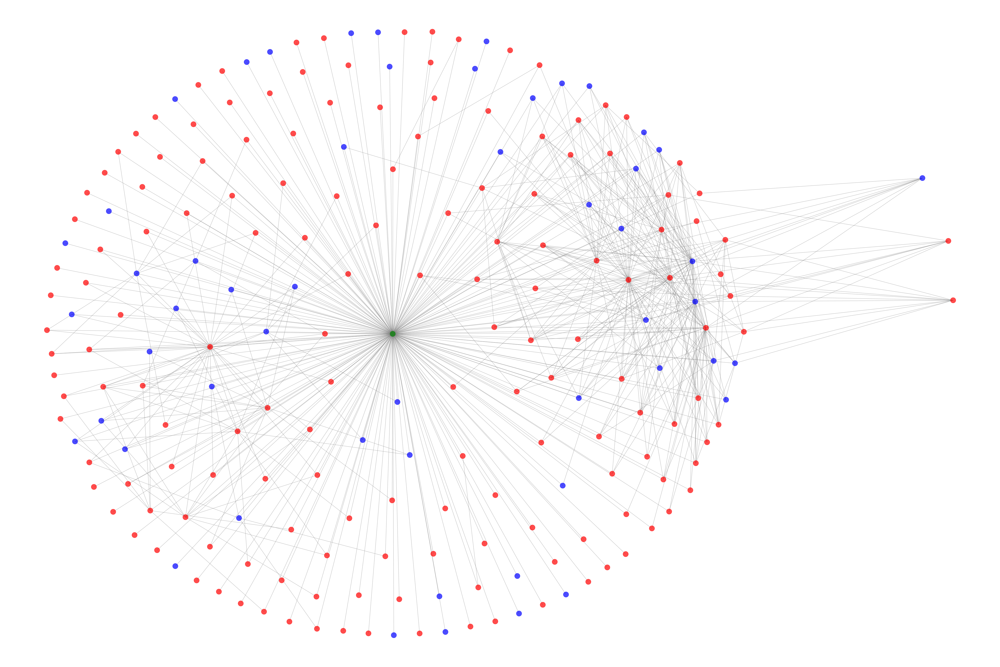

In [11]:
plt.figure(figsize=(60,40))
# Plot it
nx.draw_kamada_kawai(
    G, with_labels=False, node_size=550,
     alpha=0.7, node_color=colors,
    edge_color="gray"
)
plt.show()

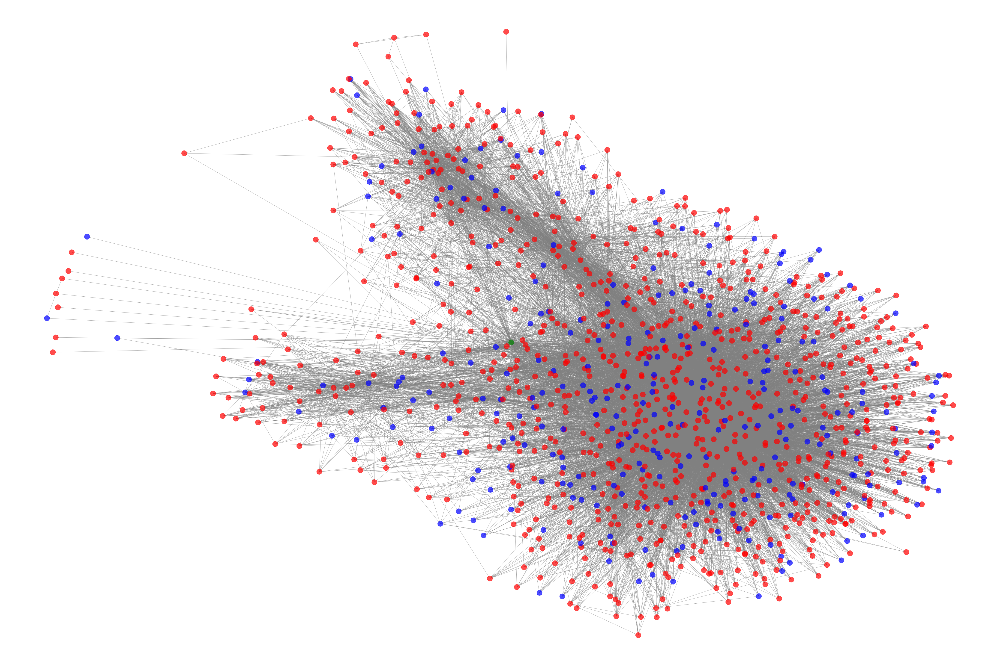

In [85]:
plt.figure(figsize=(60,40))
# Plot it
nx.draw(
    G, with_labels=False, node_size=550,
     alpha=0.7, node_color=colors,
    edge_color="gray"
)
plt.show()

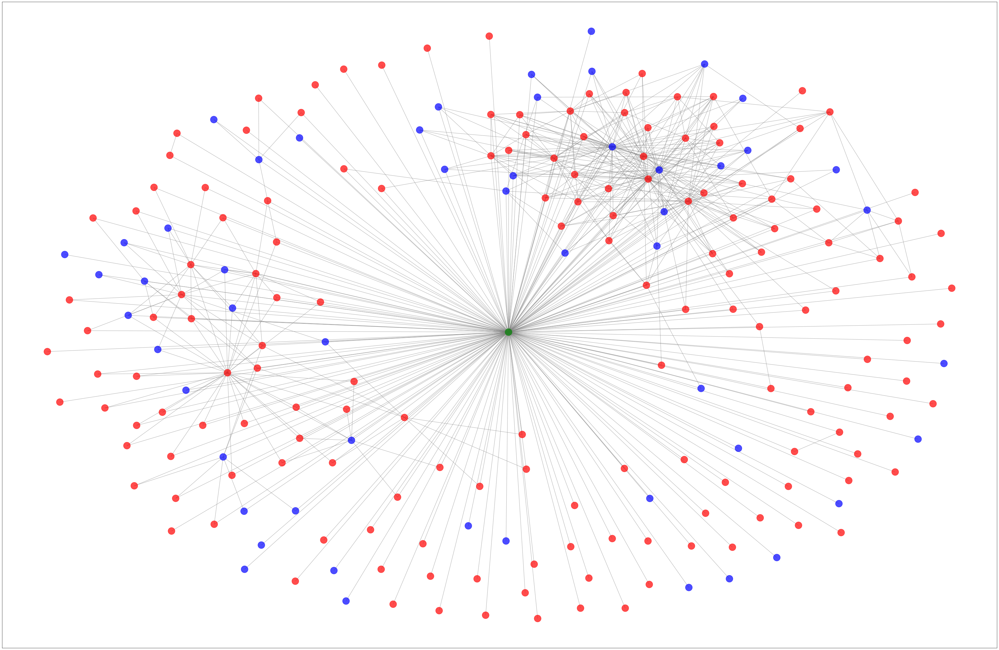

In [12]:
plt.figure(figsize=(60,40))
# Plot it
nx.draw_networkx(
    G, with_labels=False, node_size=550,
     alpha=0.7, node_color=colors,
    edge_color="gray"
)
plt.show()

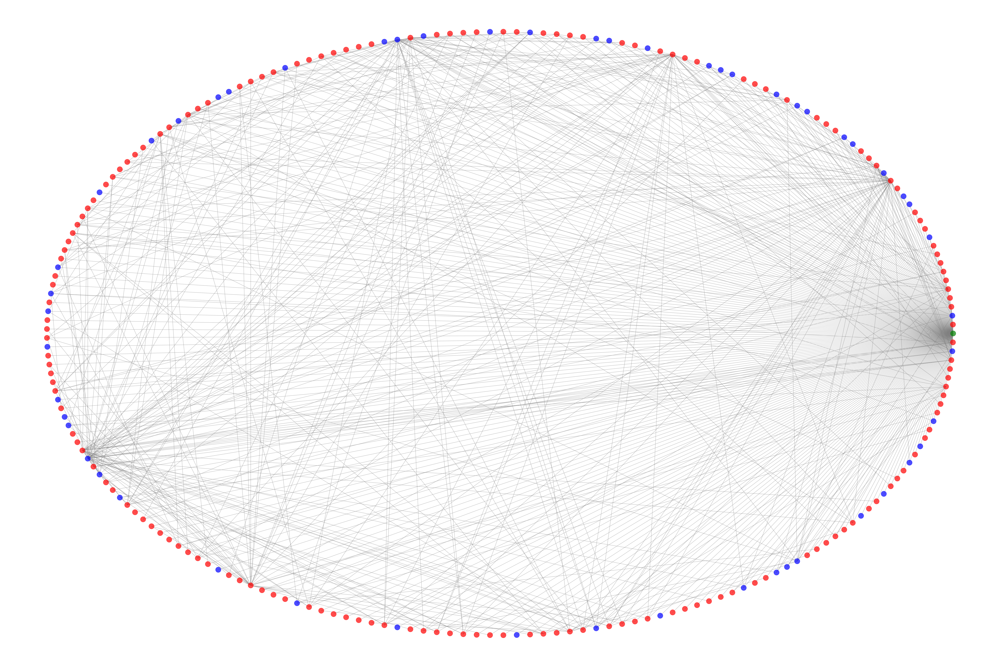

In [13]:
plt.figure(figsize=(60,40))
# Plot it
nx.draw_circular(
    G, with_labels=False, node_size=550,
     alpha=0.7, node_color=colors,
    edge_color="gray"
)
plt.show()

In [14]:
print('Order (number of nodes):', nx.number_of_nodes(G))
print('Size (number of edges):', nx.number_of_edges(G))
print('Number of connected components:', nx.number_connected_components(G))

sorted_cc = sorted(nx.connected_components(G), key = len, reverse=True)
sub_graph = G.subgraph(sorted_cc[0])
print('Radius:', nx.radius(sub_graph))
print('Diameter:', nx.diameter(sub_graph))
print('Order (number of nodes) of the largest component:', nx.number_of_nodes(sub_graph))
print('Size (number of edges) of the largest component:', nx.number_of_edges(sub_graph))

Order (number of nodes): 213
Size (number of edges): 568
Number of connected components: 1
Radius: 2
Diameter: 3
Order (number of nodes) of the largest component: 213
Size (number of edges) of the largest component: 568


In [15]:
edgelist_without_me = create_edgelist_without_me(friends_list)

# Build your graph
GWME=nx.from_pandas_edgelist(edgelist_without_me, 'from', 'to')

  1%|▊                                                                                 | 2/209 [00:00<00:16, 12.90it/s]

DEBUG: request mutual friends list:


100%|████████████████████████████████████████████████████████████████████████████████| 209/209 [00:11<00:00, 18.65it/s]


used_ids size: 150


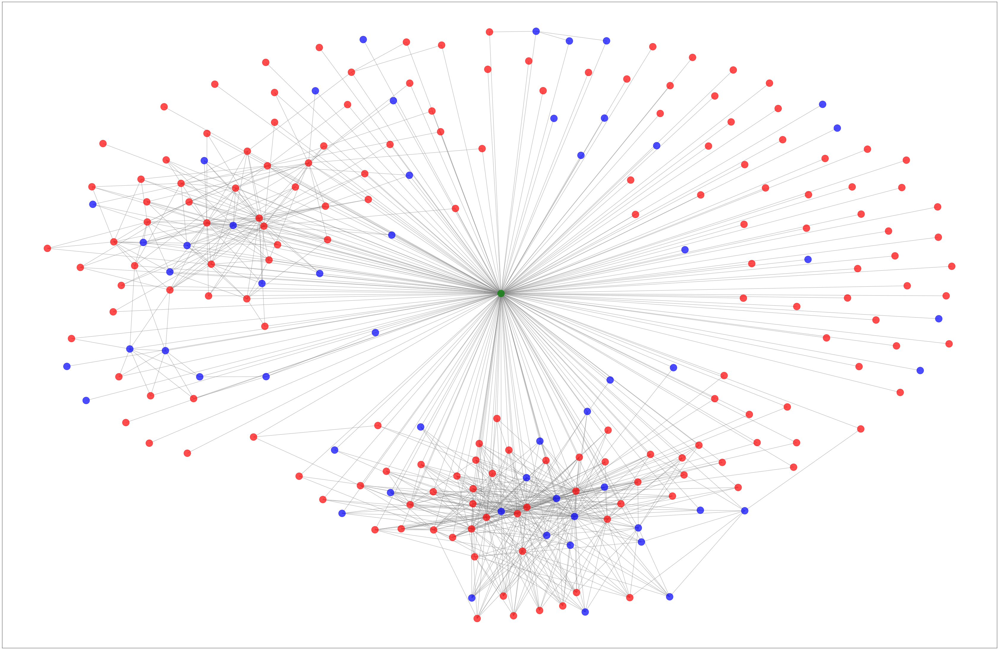

In [17]:
colors_without_me = create_colors(GWME, friends_list)


plt.figure(figsize=(60,40))
# Plot it
nx.draw_networkx(
    GWME, with_labels=False, node_size=550,
     alpha=0.7, node_color=colors_without_me,
    edge_color="gray"
)
plt.show()

#### Описательные статистики графа

In [18]:
print('Order (number of nodes):', nx.number_of_nodes(GWME))
print('Size (number of edges):', nx.number_of_edges(GWME))
print('Number of connected components:', nx.number_connected_components(GWME))

sorted_cc = sorted(nx.connected_components(GWME), key = len, reverse=True)
sub_graph = GWME.subgraph(sorted_cc[0])
print('Radius:', nx.radius(sub_graph))
print('Diameter:', nx.diameter(sub_graph))
print('Order (number of nodes) of the largest component:', nx.number_of_nodes(sub_graph))
print('Size (number of edges) of the largest component:', nx.number_of_edges(sub_graph))

Order (number of nodes): 220
Size (number of edges): 769
Number of connected components: 1
Radius: 2
Diameter: 3
Order (number of nodes) of the largest component: 220
Size (number of edges) of the largest component: 769


#### Поиск клики - https://wiki2.org/ru/Задача_о_клике

Text(0, 0.5, 'Instances')

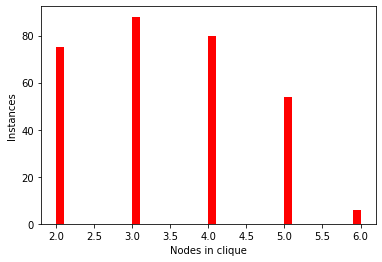

In [30]:
cliques = list(nx.find_cliques(G))
length_clique = [len(x) for x in cliques]
plt.hist(length_clique, bins=40, color='r')
plt.xlabel('Nodes in clique')
plt.ylabel('Instances')

In [31]:
max_clique = np.argmax(length_clique )
print("max_clique:", max_clique)
print("clique count:", len(length_clique))

max_clique: 122
clique count: 303


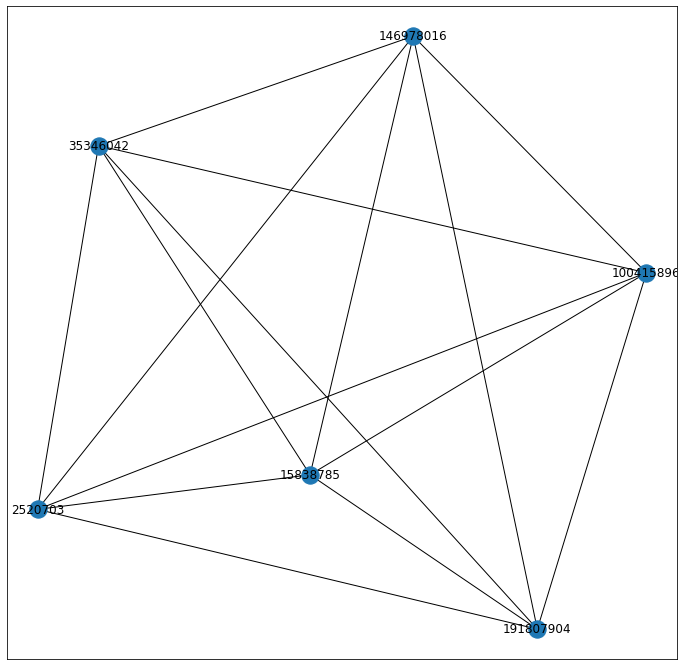

In [32]:
len(cliques[max_clique])
plt.figure(figsize=(12,12))
nx.draw_networkx(G.subgraph(cliques[max_clique]), with_labels=True)


---
---
## Кластеризация друзей и её визуализация в виде графа

In [33]:
import numpy as np
import networkx as nx
from sklearn.cluster import SpectralClustering
from sklearn import metrics
np.random.seed(1)



# Get adjacency-matrix as numpy-array
adj_mat = nx.to_numpy_matrix(G)


# Cluster
sc = SpectralClustering(5, affinity='precomputed', n_init=1000)
sc.fit(adj_mat)

# Compare ground-truth and clustering-results
print('spectral clustering')
print(sc.labels_)
print('just for better-visualization: invert clusters (permutation)')
print(np.abs(sc.labels_ - 1))




spectral clustering
[0 0 3 0 0 0 0 0 3 0 0 3 0 0 4 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 4 0 0
 0 0 0 0 2 0 0 0 0 0 0 4 0 0 0 0 4 1 4 4 2 0 0 0 0 0 0 0 3 3 0 0 4 4 0 0 4
 1 3 0 4 0 0 0 0 3 3 4 0 0 0 0 0 0 0 0 4 0 3 0 0 4 3 0 0 2 0 3 0 4 0 0 0 4
 0 4 0 4 2 4 4 0 0 0 0 0 4 0 3 4 0 0 0 3 0 0 3 3 2 3 0 0 4 4 0 0 0 1 0 3 0
 0 0 4 0 0 4 0 0 0 0 0 4 0 0 4 3 0 4 0 0 0 0 4 0 0 0 0 0 0 0 4 0 0 4 0 3 0
 4 1 0 0 3 0 0 0 0 0 0 3 0 0 0 0 0 1 3 0 0 4 4 0 0 0 0 2]
just for better-visualization: invert clusters (permutation)
[1 1 2 1 1 1 1 1 2 1 1 2 1 1 3 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 3 1 1
 1 1 1 1 1 1 1 1 1 1 1 3 1 1 1 1 3 0 3 3 1 1 1 1 1 1 1 1 2 2 1 1 3 3 1 1 3
 0 2 1 3 1 1 1 1 2 2 3 1 1 1 1 1 1 1 1 3 1 2 1 1 3 2 1 1 1 1 2 1 3 1 1 1 3
 1 3 1 3 1 3 3 1 1 1 1 1 3 1 2 3 1 1 1 2 1 1 2 2 1 2 1 1 3 3 1 1 1 0 1 2 1
 1 1 3 1 1 3 1 1 1 1 1 3 1 1 3 2 1 3 1 1 1 1 3 1 1 1 1 1 1 1 3 1 1 3 1 2 1
 3 0 1 1 2 1 1 1 1 1 1 2 1 1 1 1 1 0 2 1 1 3 3 1 1 1 1 1]


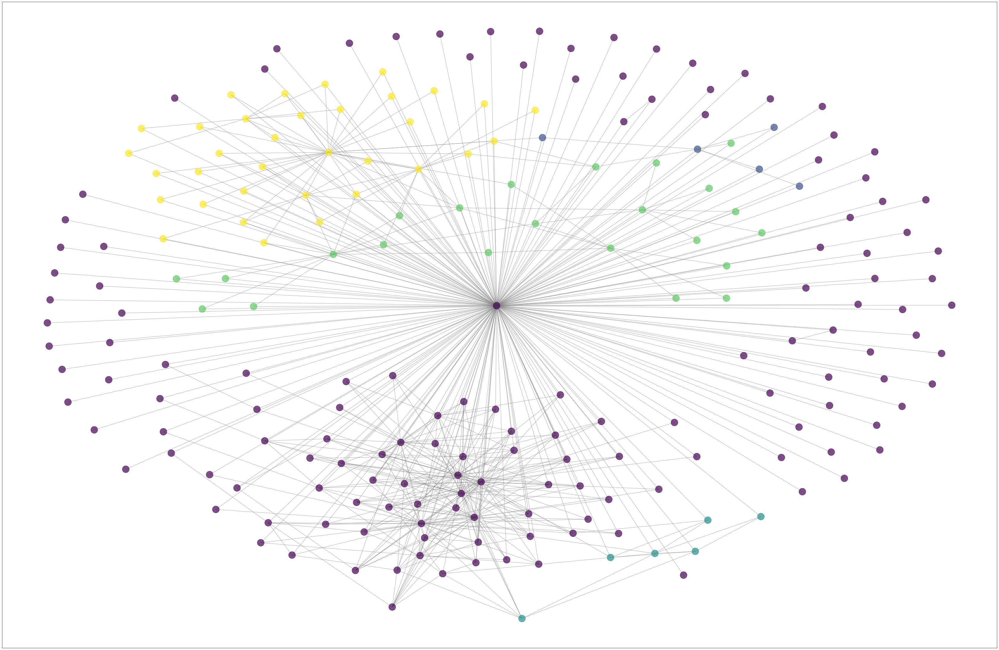

In [34]:
plt.figure(figsize=(60,40))
# Plot it
nx.draw_networkx(
    G, with_labels=False, node_size=550,
     alpha=0.7, node_color=sc.labels_,
    edge_color="gray"
)
plt.show()

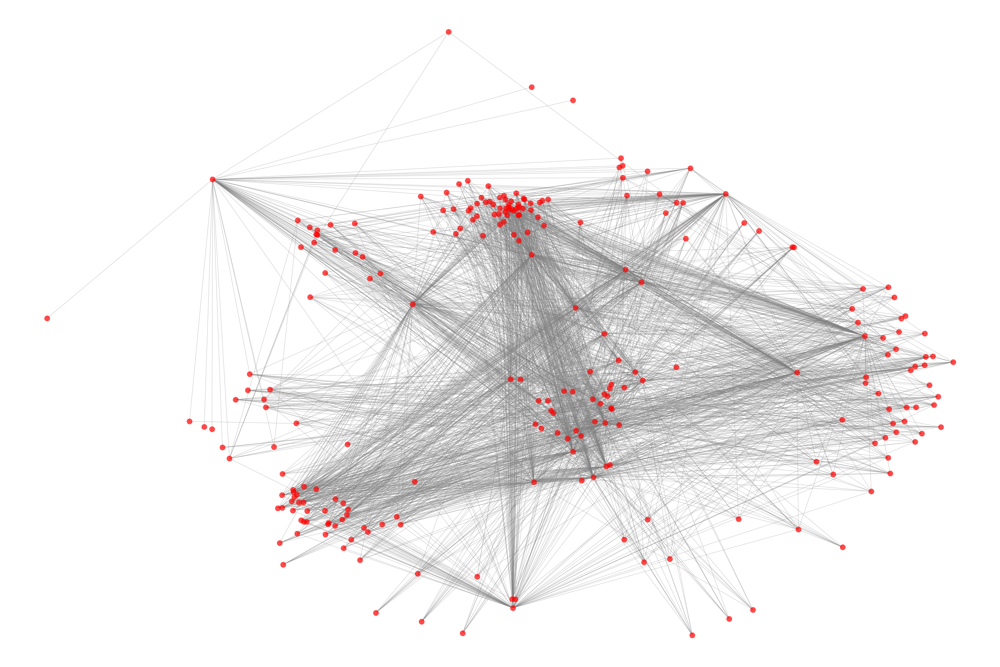

In [75]:
import random
import math

def vector_len(vector):
    return math.sqrt(vector[0] ** 2 + vector[1] ** 2)

def normalize_vector(vector):
    s = vector_len(vector)
    if s < 0.00001:
        return vector
    return [value / s for value in vector]

def build_spring_layout(G, edge_target_len = 50):
    layout = {}
    index = 0
    for v in G:
        layout[v] = [random.uniform(0, 100), random.uniform(0, 100)]
        index += 1
    
    for iteration in range(200):
        new_layout = layout.copy()
        for v in G:
            move_vector = [0., 0.]
            for u in G[v]:
                diff = [layout[u][0] - layout[v][0], layout[u][1] - layout[v][1]]
                if vector_len(diff) < edge_target_len:
                    diff[0] *= -1
                    diff[1] *= -1
                    
                diff = normalize_vector(diff)
                move_vector[0] += diff[0]
                move_vector[1] += diff[1]
            
            #move_vector = normalize_vector(diff)
            new_layout[v][0] += move_vector[0]
            new_layout[v][1] += move_vector[1]
        layout = new_layout
    return layout

plt.figure(figsize=(60,40))
nx.draw(G, pos=build_spring_layout(G), node_size=550,
     alpha=0.7, node_color='red',
    edge_color="gray")
plt.show()